# MEAN REGRESSION MODEL


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer
import seaborn as sns
import warnings

# IMPORT DATA

In [3]:
data=pd.read_csv("Transformed_Housing_Data2(1)[1].csv")
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21609 entries, 0 to 21608
Data columns (total 31 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   Sale_Price                                 21609 non-null  float64
 1   No of Bedrooms                             21609 non-null  int64  
 2   No of Bathrooms                            21609 non-null  float64
 3   Flat Area (in Sqft)                        21609 non-null  float64
 4   Lot Area (in Sqft)                         21609 non-null  float64
 5   No of Floors                               21609 non-null  float64
 6   No of Times Visited                        21609 non-null  int64  
 7   Overall Grade                              21609 non-null  int64  
 8   Area of the House from Basement (in Sqft)  21609 non-null  float64
 9   Basement Area (in Sqft)                    21609 non-null  int64  
 10  Age of House (in Years

In [4]:
# MEAN SALE PRICE

data['mean_sales']=data['Sale_Price'].mean()
data['mean_sales'].head()

0    511618.558147
1    511618.558147
2    511618.558147
3    511618.558147
4    511618.558147
Name: mean_sales, dtype: float64

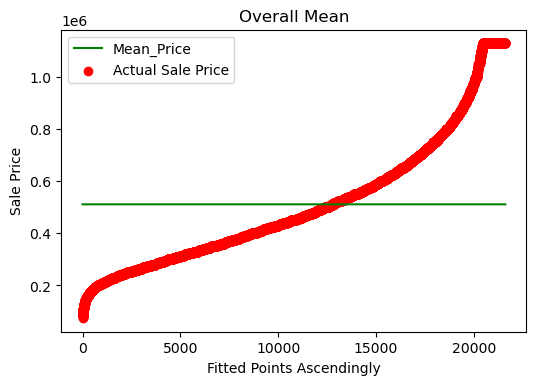

In [5]:
# Plotting relation btw Mean Sale Price and Sale Price

plt.figure(dpi=100)
k=range(0,len(data))
plt.scatter(k,data['Sale_Price'].sort_values(),color='red',label='Actual Sale Price')
plt.plot(k,data['mean_sales'].sort_values(),color='green',label='Mean_Price')
plt.xlabel('Fitted Points Ascendingly')
plt.ylabel('Sale Price')
plt.title('Overall Mean')
plt.legend()

# IMPROVING MEAN REGRESSION 

In [6]:
# Calculating Avg Sale Price w.r.t Overall Grade

grades_mean=data.pivot_table(values='Sale_Price',columns='Overall Grade',aggfunc=np.mean)
grades_mean

Overall Grade,1,2,3,4,5,6,7,8,9,10
Sale_Price,142000.0,1129575.0,205666.666667,214381.034483,248523.971074,301882.01472,402239.619779,537584.082097,736936.769025,960408.078866


In [7]:
# Storing these new values in a new column

data['grades_mean']=0
for i in grades_mean.columns:
    data['grades_mean'][data['Overall Grade']==i]=grades_mean[i][0]
data['grades_mean'].head()

<ipython-input-7-52a14d7a27d3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['grades_mean'][data['Overall Grade']==i]=grades_mean[i][0]


0    402239.619779
1    402239.619779
2    301882.014720
3    402239.619779
4    537584.082097
Name: grades_mean, dtype: float64

In [8]:
# Gradewise list

gradewise_list=[]
for i in range(1,11):
    k=data['Sale_Price'][data['Overall Grade']==i]
    gradewise_list.append(k)
    

In [9]:
# Classwise list

classwise_list=[]
for i in range(1,11):
    k=data['Sale_Price'][data['Overall Grade']==i]
    classwise_list.append(k)

In [10]:
# Comparison between Gradewise and Classwise Lists

plt.figure(dpi=120,figsize=(15,9))

# Plotting Sale Price Gradewise
# Z variable for x axis

z=0
for i in range(1,11):
    points=[k for k in range(z,z+len(classwise_list[i-1]))]

<Figure size 1800x1080 with 0 Axes>

ValueError: x and y must be the same size

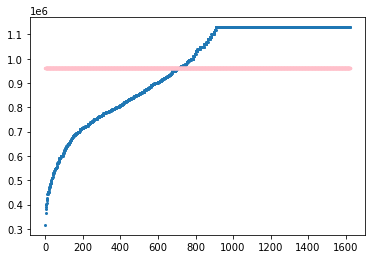

In [11]:
#Plotting

plt.scatter(points, classwise_list[i-1].sort_values(),label=("House with Overall grade", i),s=4)

# Plotting gradewise mean

plt.scatter(points, [classwise_list[i-1].mean() for q in range(len(classwise_list[i-1]))], s=6, color='pink')
z=max(points)+1

# Plotting Overall Mean

plt.scatter([q for q in range(0,z)], data['mean_sales'], color='red', label='Overall Mean', s=6)
plt.xlabel("Fitted Points (Ascending)")
plt.ylabel('Sale Price')
plt.title("Overall Mean")
plt.legend(loc=4)

# RESIDUAL PLOT

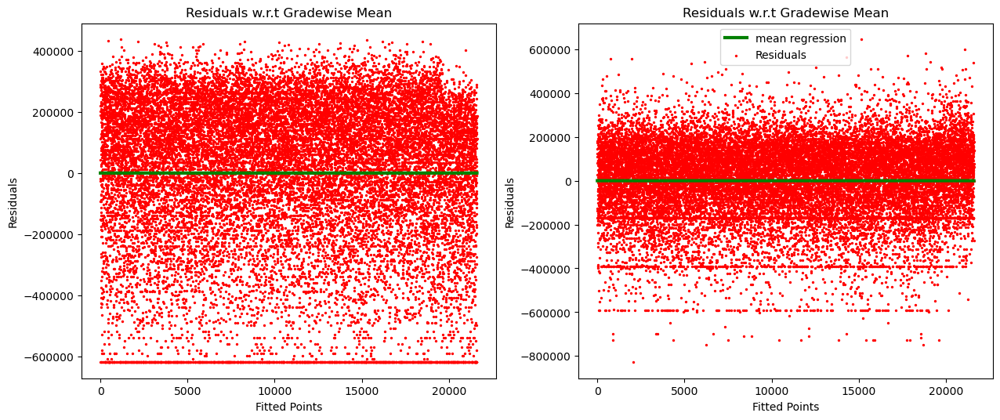

In [12]:
# RESIDUAL = PREDICTION - ACTUAL

mean_difference=data['mean_sales']-data['Sale_Price']
grade_mean_difference=data['grades_mean']-data['Sale_Price']

k=range(0,len(data))
l=[0 for i in range(len(data))]
plt.figure(figsize=(15,6),dpi=100)

plt.subplot(1,2,1)
plt.scatter(k,mean_difference,color='red',label='Residuals',s=2)
plt.plot(k,l,color='green',label='mean regression', linewidth=3)
plt.xlabel('Fitted Points')
plt.ylabel('Residuals')
plt.title('Residuals w.r.t Gradewise Mean')

plt.subplot(1,2,2)
plt.scatter(k,grade_mean_difference,color='red',label='Residuals',s=2)
plt.plot(k,l,color='green',label='mean regression', linewidth=3)
plt.xlabel('Fitted Points')
plt.ylabel('Residuals')
plt.legend()
plt.title('Residuals w.r.t Gradewise Mean')

plt.legend()


# ERRORS

In [13]:
# Errors (NORMALLY) ---> NOT PREFERRED METHOD

count=sum(mean_difference)/len(data)
print(round(count,5))

0.0


In [14]:
# Defining the variables for (Mean Absolute Error)

Y=data['Sale_Price']
Y1=data['mean_sales']
Y2=data['grades_mean']
n=len(data)

# Checking the length of each variable added

len(Y), len(Y1), len(Y2), n

(21609, 21609, 21609, 21609)

In [15]:
# Formula for MAE with mean_sales (Mean Absolute Error)

cost_mean=sum(abs(Y1-Y))/n
cost_mean

199168.78146839526

In [16]:
# Formula for MAE with grades_mean (Mean Absolute Error)

cost_grade_mean=sum(abs(Y2-Y))/n
cost_grade_mean

137081.70298203363

In [17]:
# Using sklearn library to find out MAE

from sklearn.metrics import mean_absolute_error
cost_grade_mean=mean_absolute_error(Y2,Y)
cost_grade_mean

137081.7029820291

In [18]:
# Using sklearn library to find out MSE (Mean Squared Error)

from sklearn.metrics import mean_squared_error
cost_mean=mean_squared_error(Y1,Y)
cost_grade_mean=mean_squared_error(Y2,Y)
cost_mean, cost_grade_mean

(62528116847.799576, 30804835720.342426)

In [19]:
# Using sklearn library to find out RMSE (Root Mean Squared Error)

from sklearn.metrics import mean_squared_error
cost_mean=mean_squared_error(Y1,Y)**0.5
cost_grade_mean=mean_squared_error(Y2,Y)**0.5
cost_mean, cost_grade_mean

(250056.2273725643, 175513.06424406826)

In [19]:
# R^2

Y=data['Sale_Price']
Y1=data['mean_sales']
Y2=data['grades_mean']
n=len(data)

mse_mean=mean_squared_error(Y1,Y)
mse_model=mean_squared_error(Y2,Y)
R2= 1 - mse_model/mse_mean
print(R2)

0.5073442592981836


# LINEAR REGRESSION 

In [20]:
# Importing Sale Price and Flat Area in another Dataframe

sale_price=data['Sale_Price'].head(30)
flat_area=data['Flat Area (in Sqft)'].head(30)
sample_data=pd.DataFrame({'sale_price': sale_price, 'flat_area': flat_area})
sample_data

,sale_price,flat_area
0,221900.0,1180.0
1,538000.0,2570.0
2,180000.0,770.0
3,604000.0,1960.0
4,510000.0,1680.0
5,1129575.0,5420.0
6,257500.0,1715.0
7,291850.0,1060.0
8,229500.0,1780.0
9,323000.0,1890.0


No handles with labels found to put in legend.


<function matplotlib.pyplot.show(close=None, block=None)>

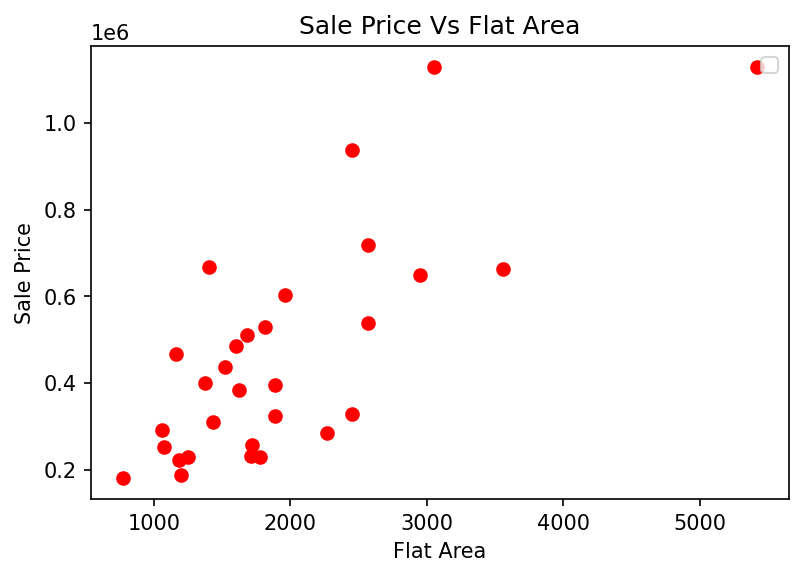

In [21]:
# Visualizing this Data

plt.figure(dpi=150)
plt.scatter(sample_data.flat_area,sample_data.sale_price,color='red')
plt.xlabel('Flat Area')
plt.ylabel('Sale Price')
plt.title('Sale Price Vs Flat Area')
plt.legend()
plt.show

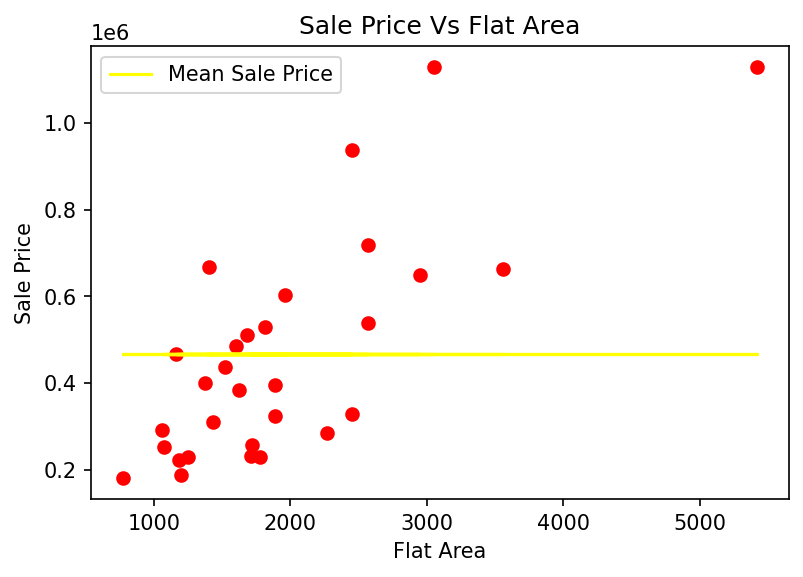

In [22]:
# Based on mean of sale price, making another column to store that and visualise the same

sample_data['mean_sale_price']=sample_data.sale_price.mean()
plt.figure(dpi=150)
plt.scatter(sample_data.flat_area,sample_data.sale_price,color='red')
plt.plot(sample_data.flat_area,sample_data.mean_sale_price,color='yellow',label='Mean Sale Price')
plt.xlabel('Flat Area')
plt.ylabel('Sale Price')
plt.title('Sale Price Vs Flat Area')
plt.legend()
plt.show()

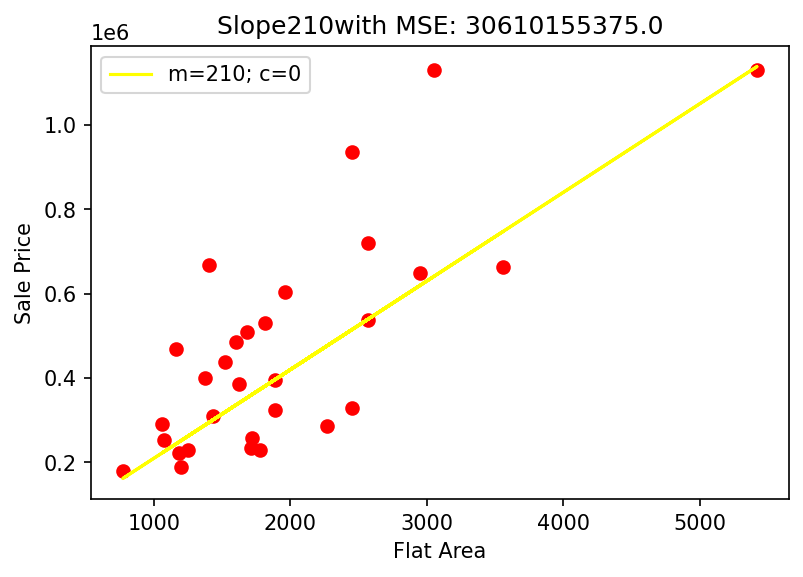

In [23]:
# Dealing the linear relation of line ( y= mx + c ) and hence, taking paramters of line ( m and c )

c=0
m=210
line=[]
for i in range(len(sample_data)):
    line.append(sample_data.flat_area[i]*m+c)

plt.figure(dpi=150)
plt.scatter(sample_data.flat_area,sample_data.sale_price,color='red')
plt.plot(sample_data.flat_area,line,color='yellow',label='m=210; c=0')
plt.xlabel('Flat Area')
plt.ylabel('Sale Price')
MSE=mean_squared_error(sample_data.sale_price,line)
plt.title('Slope' + str(m) + 'with MSE: ' + str(MSE))
plt.legend()
plt.show()

In [24]:
# We define a fnc to find the slope 

def slope_error(slope, intercept, sample_data):
    sale=[]
    for i in range(len(sample_data.flat_area)):
        tmp=sample_data.flat_area[i]*slope + intercept
        sale.append(tmp)
    MSE=mean_squared_error(sample_data.sale_price, sale)

In [25]:
slope=[i/10 for i in range(0,5000)]
Cost=[]
for i in slope:
    cost=slope_error(slope=i,intercept=0,sample_data=sample_data)
    Cost.append(cost)

In [26]:
# Arranging in dataframe

Cost_table=pd.DataFrame({'slope':slope,'cost':cost})
Cost_table.tail()

,slope,cost
4995,499.5,None
4996,499.6,None
4997,499.7,None
4998,499.8,None
4999,499.9,None


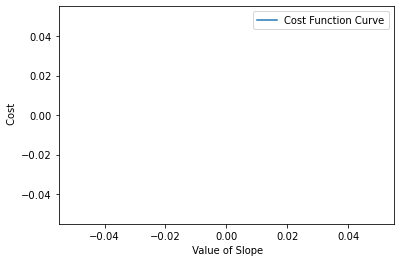

In [27]:
# Plotting the cost values w.r.t every value of slope

plt.plot(Cost_table.slope, Cost_table.cost, label='Cost Function Curve')
plt.xlabel(" Value of Slope")
plt.ylabel(" Cost")
plt.legend()

In [28]:
# Intercept Part

def intercept_error(slope,intercept,sample_data):
    sale=[]
    for i in range(len(sample_data)):
        tmp=sample_data.flat_area[i]*slope + intercept
        sale.append(tmp)
    MSE=mean_squared_error(sample_data.sale_price,sale)
    return MSE

In [30]:
intercept=[i for i in range(5000,50000)]
Cost=[]
for i in intercept:
    cost=intercept_error(slope=234,intercept=i,sample_data=sample_data)
    Cost.append(cost)
Cost_table=pd.DataFrame({'intercept':intercept,'cost':cost})
Cost_table.tail()

,intercept,cost
44995,49995,2.929894e+10
44996,49996,2.929894e+10
44997,49997,2.929894e+10
44998,49998,2.929894e+10
44999,49999,2.929894e+10


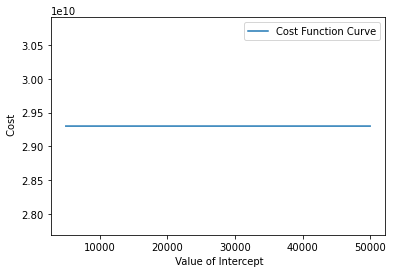

In [31]:
# Plotting the cost values w.r.t every value of intercept

plt.plot(Cost_table.intercept, Cost_table.cost, label='Cost Function Curve')
plt.xlabel(" Value of Intercept")
plt.ylabel(" Cost")
plt.legend()

In [32]:
# New intercept at at particular value, since we get approx value of optimised parameters ( c and m )

new_intercept=Cost_table['intercept'][Cost_table['cost']==Cost_table['cost'].min()].values
new_intercept[0]

5000

# IMPLEMENTING GRADIENT FUNCTION 

In [52]:
# Initializing Parameters

def param_init(Y):
    m=0.
    c=Y.mean()
    return m,c

In [53]:
# Generating Predictions

def generate_predictions(m,c,X):
    prediction=[]
    for x in X:
        pred=(m*x) + c
        prediction.append(pred)
    return prediction

In [54]:
# Calculating Cost

def compute_cost(prediction,Y):
    cost=np.sum(((prediction-Y)**2)/len(Y))
    return cost

In [55]:
# Updating Parameters (a)--> Calculating Gradients

def gradients(prediction,Y,X):
    n=len(Y)
    Gm=2/n*np.sum((prediction-Y)*X)
    Gc=2/n*np.sum((prediction-Y))
    return Gm,Gc

In [37]:
# Updating Parameters (b)--> Using gradients to update parameters

def param_update(m_old,c_old,Gm_old,Gc_old,alpha):
    m_new=m_old-(alpha*Gm_old)
    c_new=c_old-(alpha*Gc_old)
    return m_new,c_new

In [57]:
# Results 

def result(m,c,X,Y,cost,prediction,i):
    
    ''' Print and plot the final result obtained from gradeint descent '''
    # If the gradient descent converged to the optimum value before max_iter
    if i < max_iter - 1:
        print("***** Gradient Descent has converged at iteration {} ***** ".format(i))
    else:
        print("**** Result After", max_iter, "iteration is: ****")
        
    # Plotting final results 
    plt.figure(dpi=150,figsize=(14,7))
    plt.scatter(X,Y,color='red',label='data points')
    label='final regression line: m = {}; c = {}'.format(str(m),str(c))
    plt.plot(X,predictions,color='green',label=label)
    plt.xlabel('flat_area')
    plt.ylabel('sale_price')
    plt.title('final regression model')
    plt.legend()

 After Iteration 0 : m =  0.015163464136333033 : c =  1.183497744250417e-16 : Cost =  1.0000000000000004
***** Gradient Descent has converged at iteration 0 ***** 
***** Gradient Descent has converged at iteration 1 ***** 
***** Gradient Descent has converged at iteration 2 ***** 
***** Gradient Descent has converged at iteration 3 ***** 
***** Gradient Descent has converged at iteration 4 ***** 
***** Gradient Descent has converged at iteration 5 ***** 
***** Gradient Descent has converged at iteration 6 ***** 
***** Gradient Descent has converged at iteration 7 ***** 
***** Gradient Descent has converged at iteration 8 ***** 
***** Gradient Descent has converged at iteration 9 ***** 
***** Gradient Descent has converged at iteration 10 ***** 
***** Gradient Descent has converged at iteration 11 ***** 
***** Gradient Descent has converged at iteration 12 ***** 
***** Gradient Descent has converged at iteration 13 ***** 
***** Gradient Descent has converged at iteration 14 ***** 
*****

<ipython-input-57-6a3b8a0952d6>:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(dpi=150,figsize=(14,7))


***** Gradient Descent has converged at iteration 22 ***** 
***** Gradient Descent has converged at iteration 23 ***** 
***** Gradient Descent has converged at iteration 24 ***** 
***** Gradient Descent has converged at iteration 25 ***** 
***** Gradient Descent has converged at iteration 26 ***** 
***** Gradient Descent has converged at iteration 27 ***** 
***** Gradient Descent has converged at iteration 28 ***** 
***** Gradient Descent has converged at iteration 29 ***** 
***** Gradient Descent has converged at iteration 30 ***** 
***** Gradient Descent has converged at iteration 31 ***** 
***** Gradient Descent has converged at iteration 32 ***** 
***** Gradient Descent has converged at iteration 33 ***** 
***** Gradient Descent has converged at iteration 34 ***** 
***** Gradient Descent has converged at iteration 35 ***** 
***** Gradient Descent has converged at iteration 36 ***** 
***** Gradient Descent has converged at iteration 37 ***** 
***** Gradient Descent has converged at 

***** Gradient Descent has converged at iteration 153 ***** 
***** Gradient Descent has converged at iteration 154 ***** 
***** Gradient Descent has converged at iteration 155 ***** 
***** Gradient Descent has converged at iteration 156 ***** 
***** Gradient Descent has converged at iteration 157 ***** 
***** Gradient Descent has converged at iteration 158 ***** 
***** Gradient Descent has converged at iteration 159 ***** 
 After Iteration 160 : m =  0.7288530276874656 : c =  1.6816178079655716e-16 : Cost =  0.42606850810734553
***** Gradient Descent has converged at iteration 160 ***** 
***** Gradient Descent has converged at iteration 161 ***** 
***** Gradient Descent has converged at iteration 162 ***** 
***** Gradient Descent has converged at iteration 163 ***** 
***** Gradient Descent has converged at iteration 164 ***** 
***** Gradient Descent has converged at iteration 165 ***** 
***** Gradient Descent has converged at iteration 166 ***** 
***** Gradient Descent has converged at

***** Gradient Descent has converged at iteration 287 ***** 
***** Gradient Descent has converged at iteration 288 ***** 
***** Gradient Descent has converged at iteration 289 ***** 
***** Gradient Descent has converged at iteration 290 ***** 
***** Gradient Descent has converged at iteration 291 ***** 
***** Gradient Descent has converged at iteration 292 ***** 
***** Gradient Descent has converged at iteration 293 ***** 
***** Gradient Descent has converged at iteration 294 ***** 
***** Gradient Descent has converged at iteration 295 ***** 
***** Gradient Descent has converged at iteration 296 ***** 
***** Gradient Descent has converged at iteration 297 ***** 
***** Gradient Descent has converged at iteration 298 ***** 
***** Gradient Descent has converged at iteration 299 ***** 
 After Iteration 300 : m =  0.7564401323805068 : c =  1.6731060981101123e-16 : Cost =  0.4251765158570681
***** Gradient Descent has converged at iteration 300 ***** 
***** Gradient Descent has converged at 

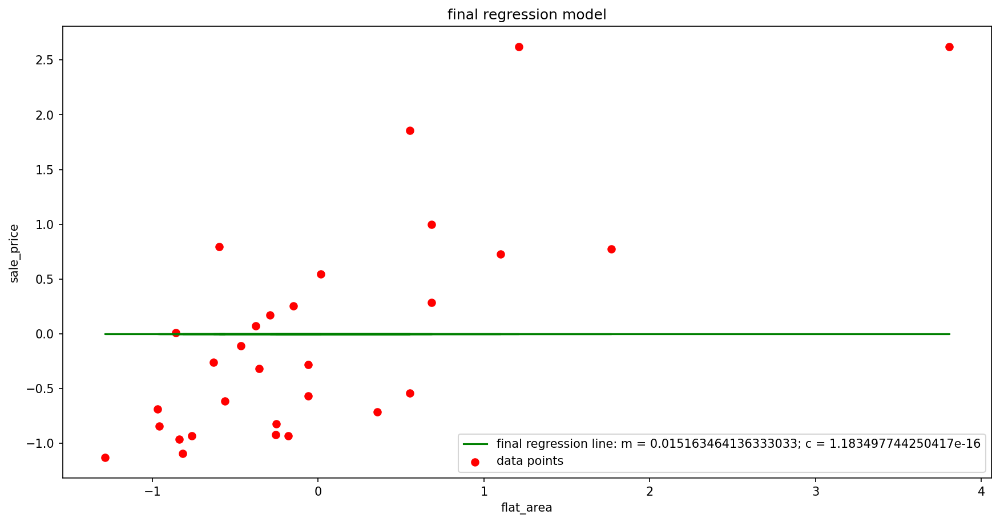

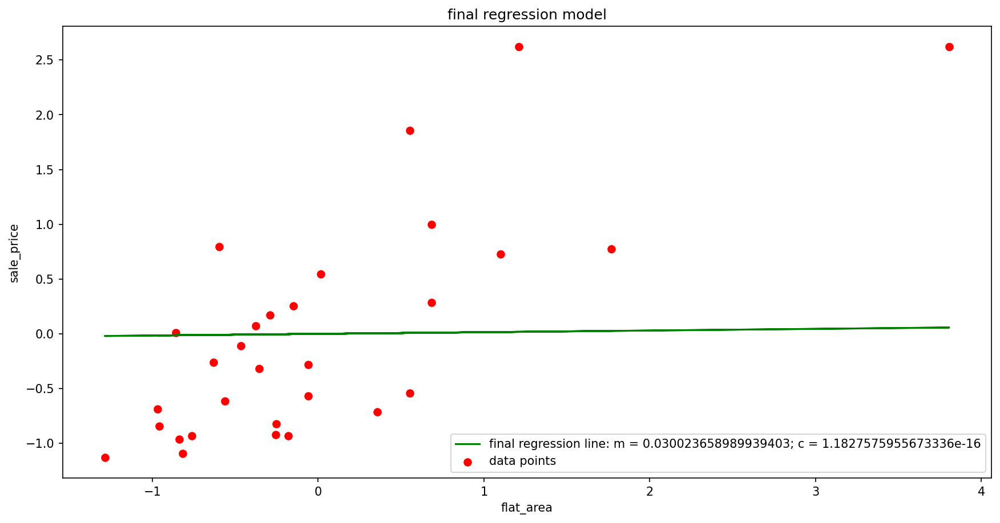

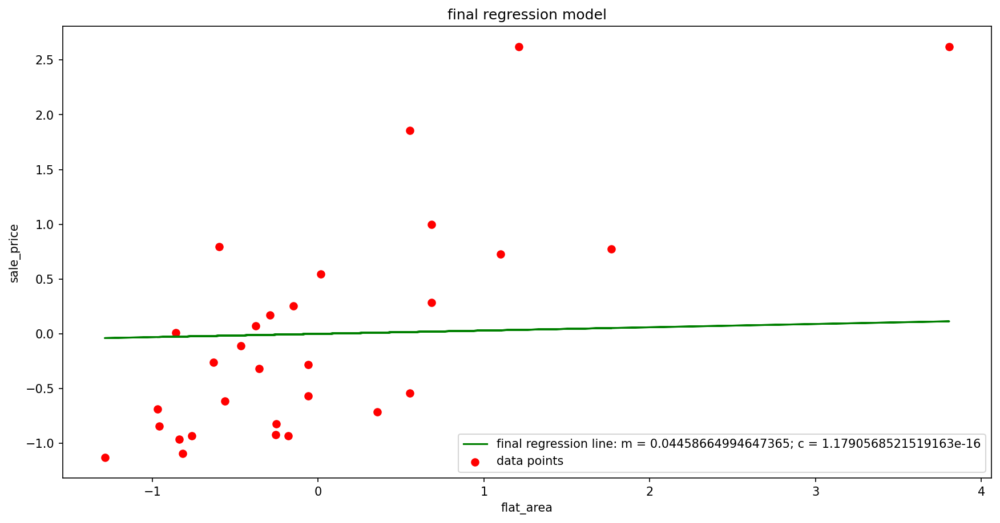

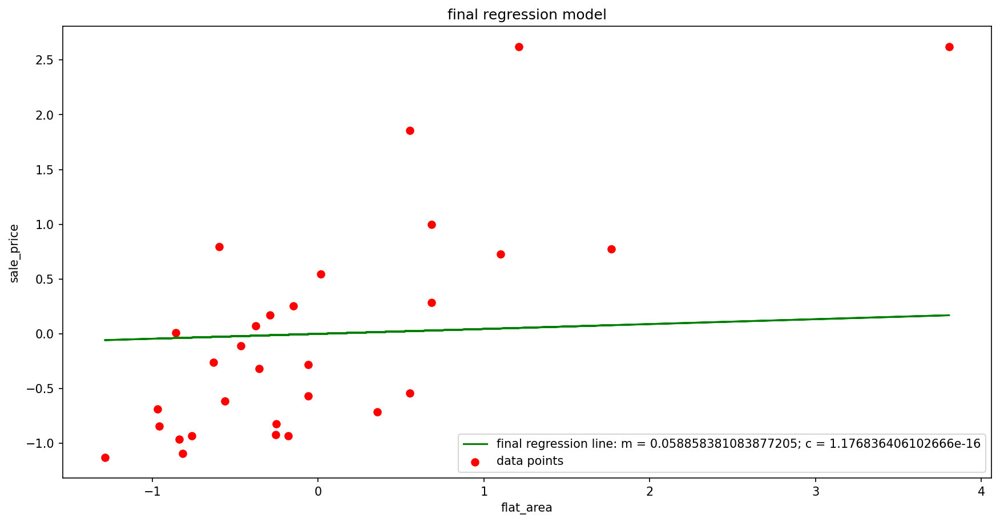

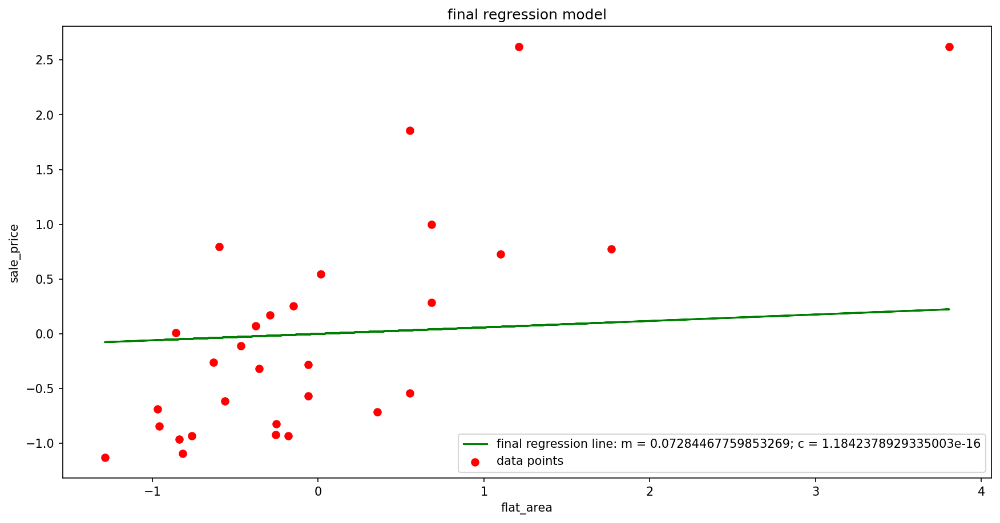

...

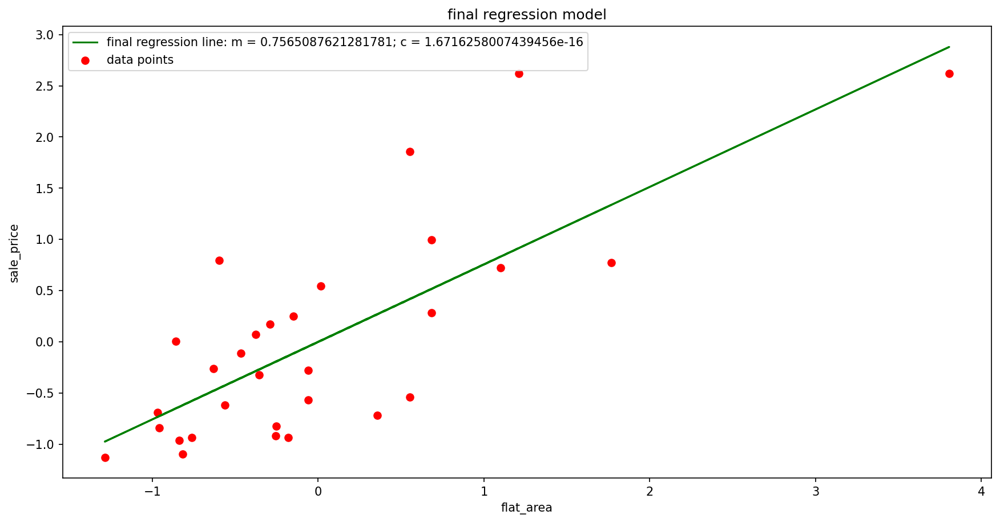

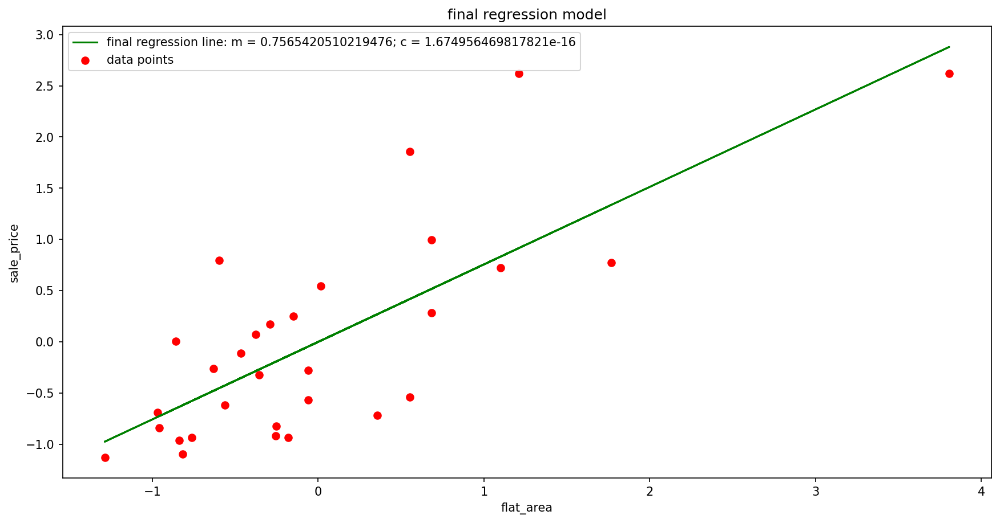

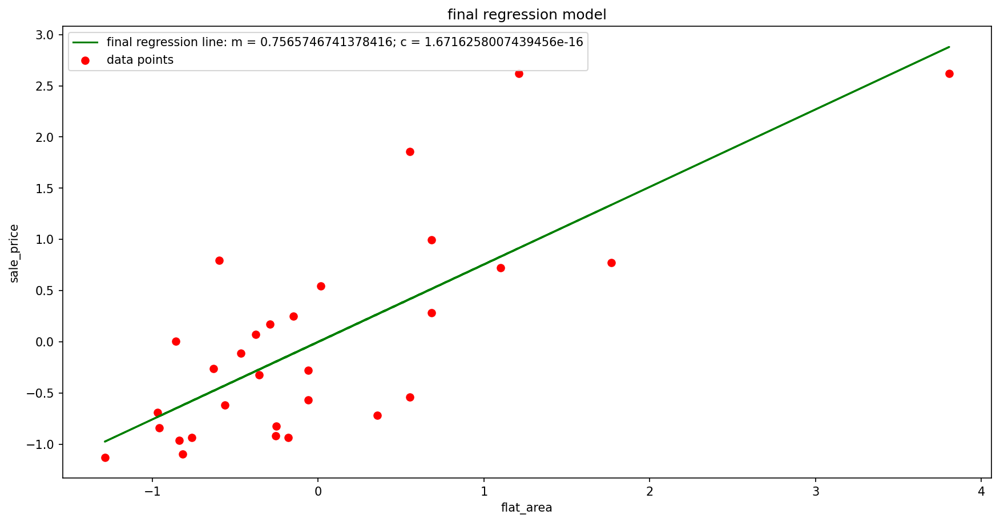

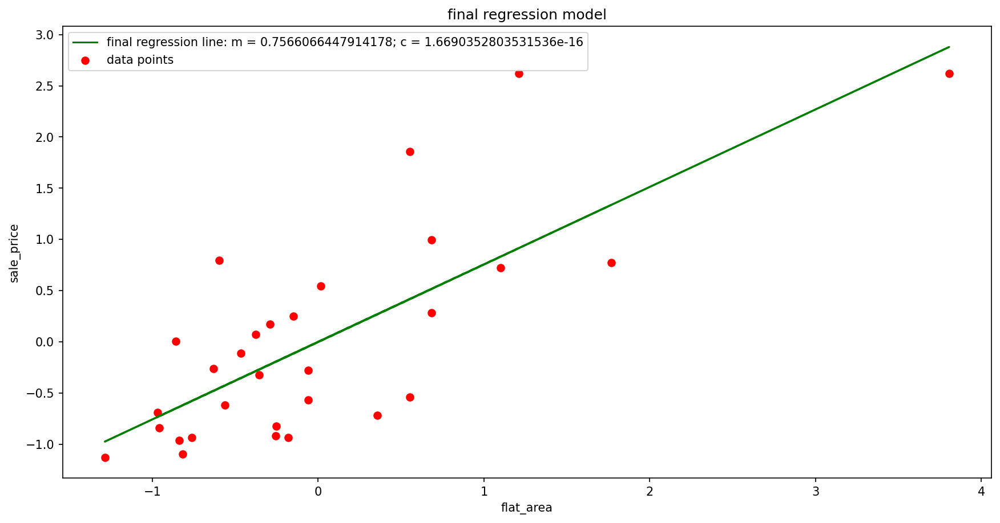

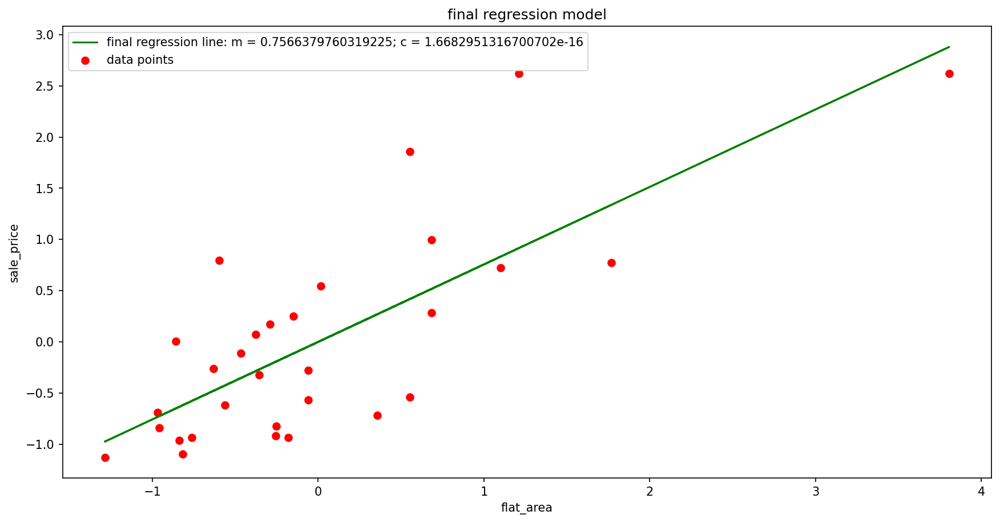

In [58]:
# Defining dataset and reshaping data and scaling data before to avoid inifnite looping values

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()

sale_price=scaler.fit_transform(sample_data['sale_price'].values.reshape(-1,1))
flat_area=scaler.fit_transform(sample_data['flat_area'].values.reshape(-1,1))

# Declaring Parameters
max_iter=1000
cost_old=0
alpha=0.01

# Step 1: Function calling (param_init)
m,c=param_init(sale_price)

# Gradient Descent in action
for i in range(0,max_iter):
    
    # Step 2: Function Calling (Generating Fnc.)
    predictions= generate_predictions(m,c, flat_area)
    
    # Step 3: Function Calling (Calculating Cost)
    cost_new= compute_cost(predictions, sale_price)
    
    # Checking if Gradient Descent is coverged or not
    if abs(cost_new - cost_old)<10**(-7):
        break
        
    # Calculating Gradients
    Gm,Gc= gradients(predictions, sale_price, flat_area)
    
    # Step 4: Function Calling (Updating parameters m and c)
    m,c=param_update(m,c,Gm,Gc,alpha)
    
    # Display result after every 20 iterations
    if i%20==0:
        print(" After Iteration", i , ": m = ", m, ": c = ", c, ": Cost = ", cost_new)
        
    # updating cost_old
    cost_old=cost_new
    
    ## Final Results ##
    result(m,c,flat_area,sale_price,cost_new,predictions,i)
